In [4]:
import squidpy as sq
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scanpy as sc
import numpy as np
import pandas as pd
import anndata as ad
from scipy import sparse

In [5]:
sc.settings.verbosity = 3  
# verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80, facecolor='white', frameon=True, figsize=(5, 5))

-----
anndata     0.9.1
scanpy      1.9.3
-----
PIL                         9.1.1
PyQt5                       NA
anyio                       NA
appdirs                     1.4.4
asciitree                   NA
attr                        21.2.0
babel                       2.9.1
backcall                    0.2.0
brotli                      NA
cachey                      0.2.1
certifi                     2022.12.07
cffi                        1.15.0
charset_normalizer          2.0.7
cloudpickle                 2.2.0
colorama                    0.4.6
cycler                      0.10.0
cython_runtime              NA
cytoolz                     0.12.1
dask                        2023.5.1
dask_image                  2022.09.0
dateutil                    2.8.2
debugpy                     1.5.0
decorator                   5.1.1
defusedxml                  0.7.1
dill                        0.3.6
docrep                      0.3.2
docstring_parser            NA
entrypoints                 0.3
fa33

In [6]:
# samples_dict = {"Immature": "A0021_043", "0hr": "A0008_041", "1hr": "A0021_044", "4hr": "A0008_045", "4hr_replicate": "A0021_042", "6hr": "A0021_045", "8hr": "A0008_044", "8hr_replicate": "A0021_038", "11hr": "A0008_046", "12hr": "A0021_046"}
samples_dict = {"Immature": "A0021_043", "0hr": "A0008_041", "1hr": "A0021_044", "4hr": "A0021_042", "6hr": "A0021_045", "8hr": "A0008_044", "11hr": "A0008_046", "12hr": "A0021_046"}

In [10]:
adata_dict = dict()
for sample in samples_dict.keys():
        adata_dict[sample] = sc.read_h5ad("./../../pyobjs_github/adata_"+ sample + "_with_image_processed_undertissue_filtered_reprocessed_refiltered_integrated.h5ad")
        adata_dict[sample].uns['log1p'] = {'base' : None}


In [5]:
arr = np.ones((10000, 10000, 3))

print(arr.shape)
img = sq.im.ImageContainer(arr, layer="img1")
img

(10000, 10000, 3)
Adding image layer `img1`


ImageContainer[shape=(10000, 10000), layers=['img1']]

In [15]:
adata = adata_dict["8hr"]
adata.uns["spatial"] = {"0" : {"images" : dict(), 'metadata': dict(), "scalefactors" : {"spot_diameter_fullres" : 25}}}

In [7]:
# adata.obs["x"] = adata.obs["x"] - min(adata.obs["x"])
# adata.obs["y"] = adata.obs["y"] - min(adata.obs["y"])

In [16]:
arr = np.ones((6000, 6000, 3))
print(arr.shape)
img = sq.im.ImageContainer(arr, layer="img1")
img

(6000, 6000, 3)
Adding image layer `img1`


ImageContainer[shape=(6000, 6000), layers=['img1']]

In [ ]:
viewer = img.interactive(adata)

In [13]:
adata

AnnData object with n_obs × n_vars = 11698 × 2537
    obs: 'barcode', 'x', 'y', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'individual_leiden_1.0', 'individual_leiden_1.2', 'individual_leiden_1.5', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden_1.0', 'leiden_1.5', 'Level1_total_abundance', 'Level1_EN_Blood', 'Level1_EN_Lymph', 'Level1_Epithelium', 'Level1_GC_Antral', 'Level1_GC_Atretic', 'Level1_GC_CL_Active', 'Level1_GC_CL_Lytic', 'Level1_GC_Estrous', 'Level1_GC_Mitotic', 'Level1_GC_Mural', 'Level1_GC_Preantral', 'Level1_I_B_Cell', 'Level1_I_Dendritic_Cell', 'Level1_I_Granulocyte', 'Level1_I_Macrophage', 'Level1_I_T_Cell', 'Level1_M_Cortical Stroma', 'Level1_M_Dividing Mesenchyme', 'Level1_M_Immature Theca', 'Level1_M_Medullary Stroma', 'Level1_M_Pericyte', 'Level1_M_Smooth Muscle', 'Level1_M_Steroidogenic Theca', 'Level1_Oocyte', 'Level1_max_pred', 'Level1_max_pred_celltype', 'Level1_max_pred_celltype_group', 'Level0_total_abundance', 'Le

In [14]:
adata.write_h5ad("./../pyobjs/adata_11hr_napari_apex_base.h5ad")

In [21]:
adata.write_h5ad("./../pyobjs/adata_8hr_napari_apex_base.h5ad")

In [1]:
adata = sc.read_h5ad("./../pyobjs/adata_11hr_napari_apex_base.h5ad")

NameError: name 'sc' is not defined

In [ ]:
for sample in samples_dict.keys():
    adata_dict[sample].obs = sc.read_h5ad("./../../pyobjs_github/adata_" + sample + "_napari.h5ad").obs
    print(adata_dict[sample].obs.shape)

In [20]:
for sample in samples_dict.keys():
    adata_dict[sample].write_h5ad("./../../pyobjs_github/adata_" + sample + "_napari.h5ad")
    print(adata_dict[sample].obs.shape)

(22801, 158)
(13304, 95)


... storing 'Sample' as categorical


(19652, 92)
(13537, 80)
(13197, 88)
(10450, 89)
(11698, 95)
(16897, 92)


In [21]:
for sample in samples_dict.keys():
    adata_dict[sample].obs = sc.read_h5ad("./../../pyobjs_github/adata_" + sample + "_napari.h5ad").obs
    print(adata_dict[sample].obs.shape)

(22801, 158)
(13304, 95)
(19652, 92)
(13537, 80)
(13197, 88)
(10450, 89)
(11698, 95)
(16897, 92)


In [22]:
counter = 0
for sample in samples_dict.keys():
    print(sample, ":", adata_dict[sample].shape)
    roi_names = adata_dict[sample].obs.columns[[x.startswith("Shapes") for x in list(adata_dict[sample].obs.columns)]].values
    roi_df = adata_dict[sample].obs[adata_dict[sample].obs.columns[[x.startswith("Shapes") for x in list(adata_dict[sample].obs.columns)]]]
    print(roi_df.shape)
    roi_df.columns = ["Follicle" + str(counter + n) for n in range(0, roi_df.shape[1])]
    counter += roi_df.shape[1]
    roi_names = roi_df.columns.values
    adata_dict[sample].obs['FollicleNumber'] = roi_df.apply(lambda row : pd.NA if len(roi_names[row.values]) == 0 else roi_names[row.values][0], axis=1)

Immature : (22801, 2537)
(22801, 102)
0hr : (13304, 2537)
(13304, 39)
1hr : (19652, 2537)
(19652, 36)
4hr : (13537, 2537)
(13537, 24)
6hr : (13197, 2537)
(13197, 32)
8hr : (10450, 2537)
(10450, 33)
11hr : (11698, 2537)
(11698, 39)
12hr : (16897, 2537)
(16897, 36)


... storing 'FollicleNumber' as categorical


Immature : (22801, 2537)


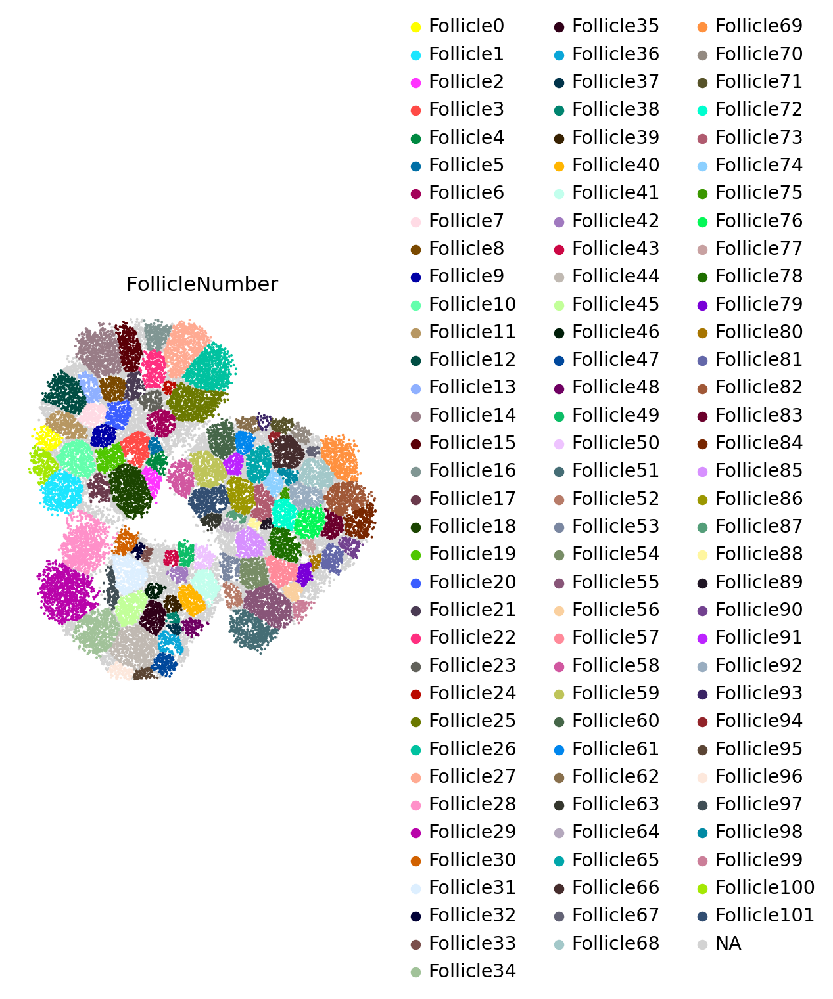

... storing 'FollicleNumber' as categorical


0hr : (13304, 2537)


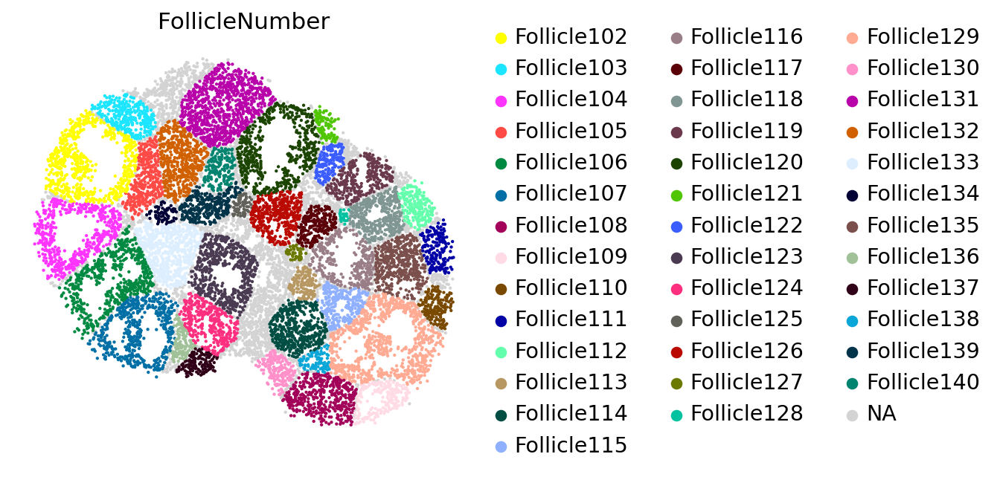

... storing 'FollicleNumber' as categorical


1hr : (19652, 2537)


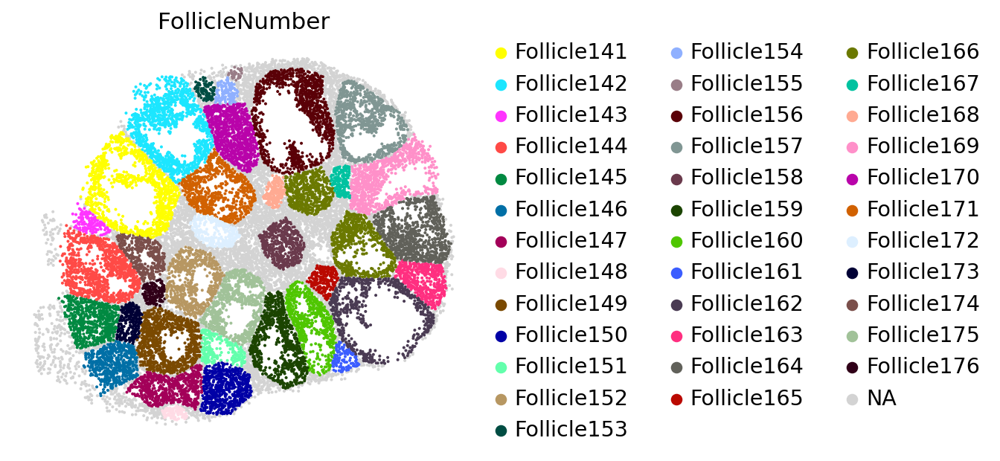

... storing 'FollicleNumber' as categorical


4hr : (13537, 2537)


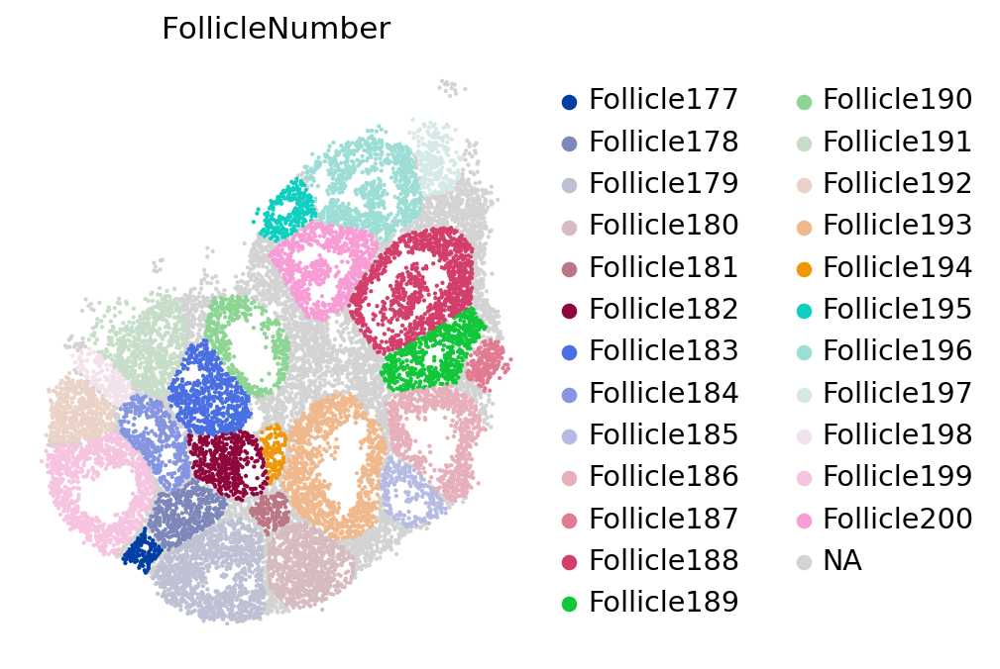

... storing 'FollicleNumber' as categorical


6hr : (13197, 2537)


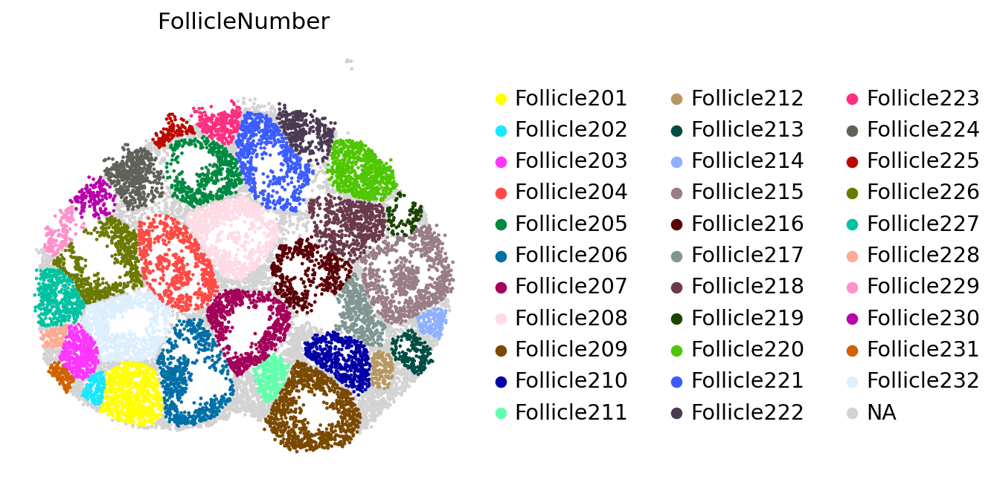

... storing 'FollicleNumber' as categorical


8hr : (10450, 2537)


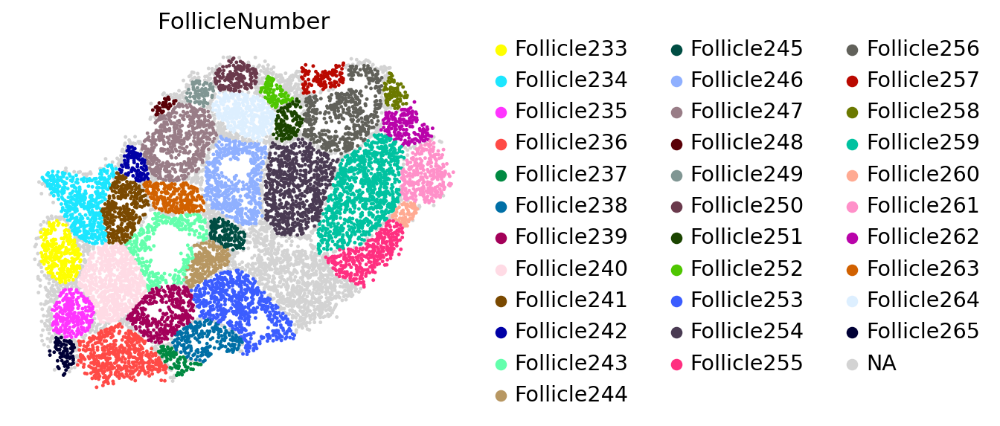

... storing 'FollicleNumber' as categorical


11hr : (11698, 2537)


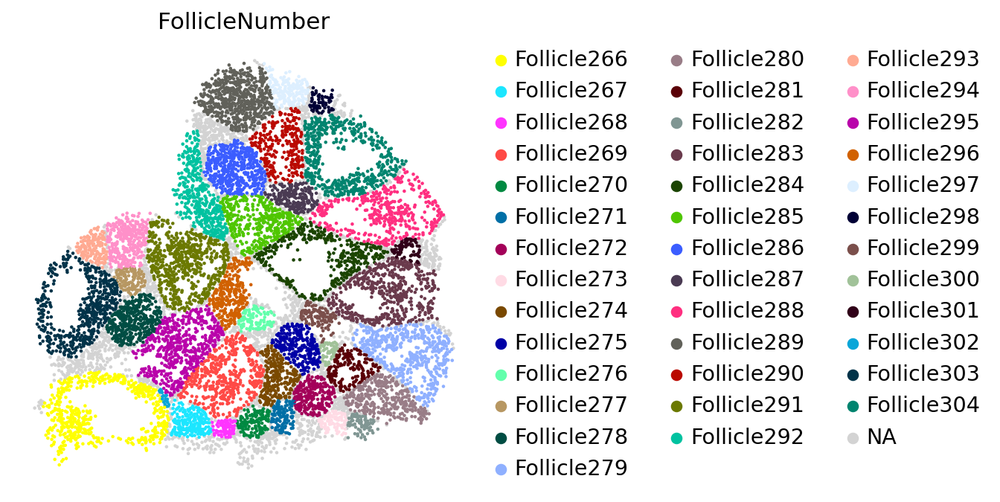

... storing 'FollicleNumber' as categorical


12hr : (16897, 2537)


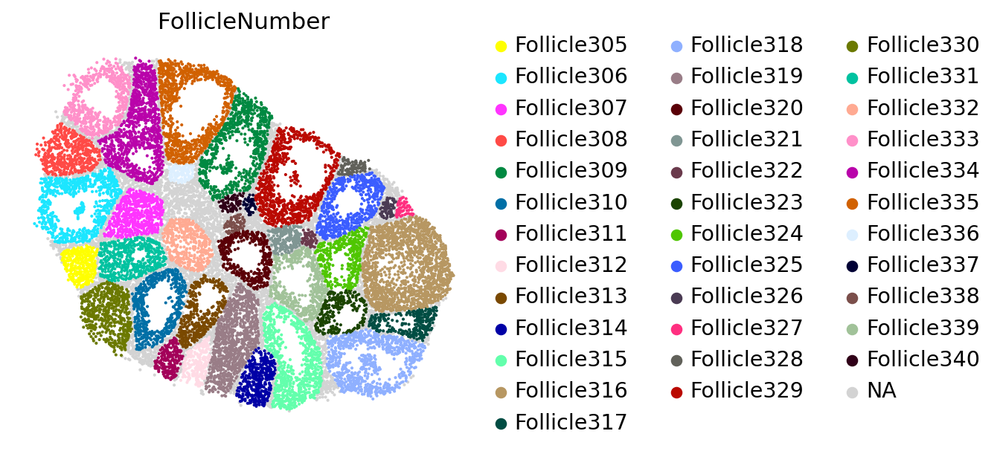

In [23]:
for sample in samples_dict.keys():
    print(sample, ":", adata_dict[sample].shape)
    sc.pl.spatial(adata_dict[sample], color=["FollicleNumber"], spot_size=30, frameon=False, wspace=0.3)

In [25]:
for sample in samples_dict.keys():
    print(sample, ":", adata_dict[sample].shape)
    adata_dict[sample].write_h5ad("./../../pyobjs_github/adata_" + sample + "_napari_corrected.h5ad")

Immature : (22801, 2537)
0hr : (13304, 2537)
1hr : (19652, 2537)
4hr : (13537, 2537)
6hr : (13197, 2537)
8hr : (10450, 2537)
11hr : (11698, 2537)
12hr : (16897, 2537)


In [ ]:
adata_dict = dict
for sample in samples_dict.keys():
    print(sample, ":", adata_dict[sample].shape)
    adata_dict[sample].write_h5ad("./../../pyobjs_github/adata_" + sample + "_napari_corrected.h5ad")

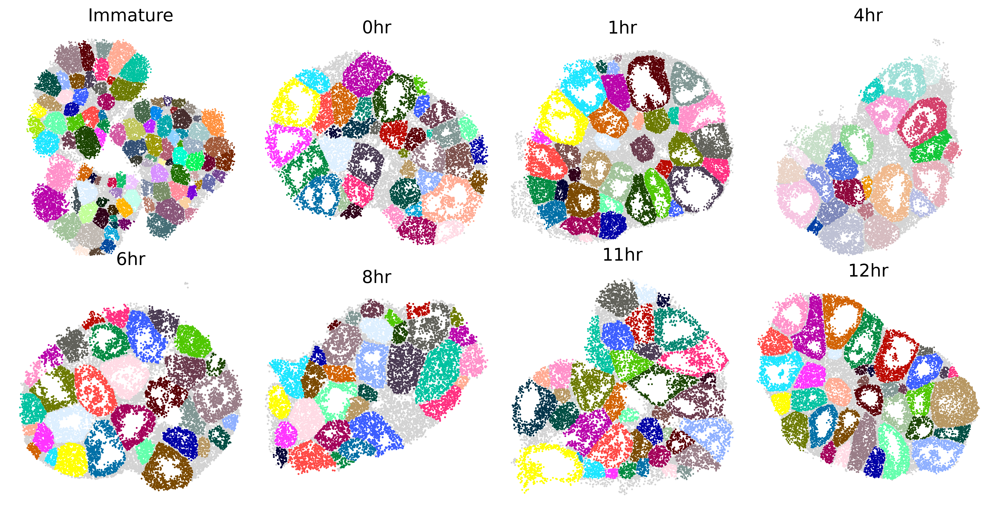

In [27]:
sc.settings.set_figure_params(dpi=300, dpi_save= 300, fontsize=16, facecolor='white', frameon=False, figsize=(2.0, 2.0), vector_friendly = True, transparent=True, format="pdf")
grouping_var = "FollicleNumber"
fig, axs = plt.subplots(2,4, figsize = (16,8))
for i, sample in enumerate(samples_dict.keys()):
    subset = adata_dict[sample]
#     subset.obs[grouping_var] = subset.obs[grouping_var].cat.set_categories(adata_ovary_combined.obs[grouping_var].cat.categories)
#     print(subset.obs[grouping_var].cat.categories)
    if i == 3:
        sc.pl.spatial(subset, color = [grouping_var], wspace= 0.0, hspace = 0.0, spot_size = 30, frameon=False, title=sample, show=False, ax=axs[int(i/4), int(i%4)], na_color="lightgrey")
        handles, labels = axs[int(i/4), int(i%4)].get_legend_handles_labels()
        axs[int(i/4), int(i%4)].get_legend().remove()
    else: 
        sc.pl.spatial(subset, color = [grouping_var], wspace= 0.0, hspace = 0.0, spot_size = 30, frameon=False, title=sample, show=False, legend_loc="none", ax=axs[int(i/4), int(i%4)], na_color="lightgrey")  
# fig.legend(handles, labels, ncol = 5,loc='none', bbox_to_anchor = (0.57,0.05), title = "Ovarian Follicles")
plt.subplots_adjust(wspace=0, hspace=0)
# plt.savefig("./figures/spatial_maps_granulosa.pdf")

In [28]:
adata_ovary_combined = adata_dict[list(samples_dict.keys())[0]].raw.to_adata().concatenate([adata_dict[x].raw.to_adata() for x in list(samples_dict.keys())[1:]])
adata_ovary_combined.obs_names = [x.split("-")[0] + "-" + x.split("-")[1] for x in adata_ovary_combined.obs_names]
adata_ovary_combined

/home/mm2937/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1755: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


AnnData object with n_obs × n_vars = 121536 × 31053
    obs: 'barcode', 'x', 'y', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'individual_leiden_1.0', 'individual_leiden_1.2', 'individual_leiden_1.5', 'spatial_neighbors_100_true', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden_1.0', 'leiden_1.5', 'Level1_total_abundance', 'Level1_EN_Blood', 'Level1_EN_Lymph', 'Level1_Epithelium', 'Level1_GC_Antral', 'Level1_GC_Atretic', 'Level1_GC_CL_Active', 'Level1_GC_CL_Lytic', 'Level1_GC_Estrous', 'Level1_GC_Mitotic', 'Level1_GC_Mural', 'Level1_GC_Preantral', 'Level1_I_B_Cell', 'Level1_I_Dendritic_Cell', 'Level1_I_Granulocyte', 'Level1_I_Macrophage', 'Level1_I_T_Cell', 'Level1_M_Cortical Stroma', 'Level1_M_Dividing Mesenchyme', 'Level1_M_Immature Theca', 'Level1_M_Medullary Stroma', 'Level1_M_Pericyte', 'Level1_M_Smooth Muscle', 'Level1_M_Steroidogenic Theca', 'Level1_Oocyte', 'Level1_max_pred', 'Level1_max_pred_celltype', 'Level1_max_pred_celltype_group

In [30]:
adata_ovary_combined.write_h5ad("./../../pyobjs_github/adata_ovary_combined_napari_processed.h5ad")

In [ ]:
adata_dict = dict()
for sample in samples_dict.keys():
        adata_dict[sample] = sc.read_h5ad("./../pyobjs/adata_"+ sample + "_with_image_processed_undertissue_filtered_reprocessed_refiltered_integrated.h5ad")
        adata_dict[sample].uns['log1p'] = {'base' : None}
        adata_dict
        

In [143]:
for sample in samples_dict.keys():
    print(sample, ":", adata_dict[sample].shape)
    adata_dict[sample].write_h5ad("./../pyobjs/adata_" + sample + "_napari_corrected.h5ad")

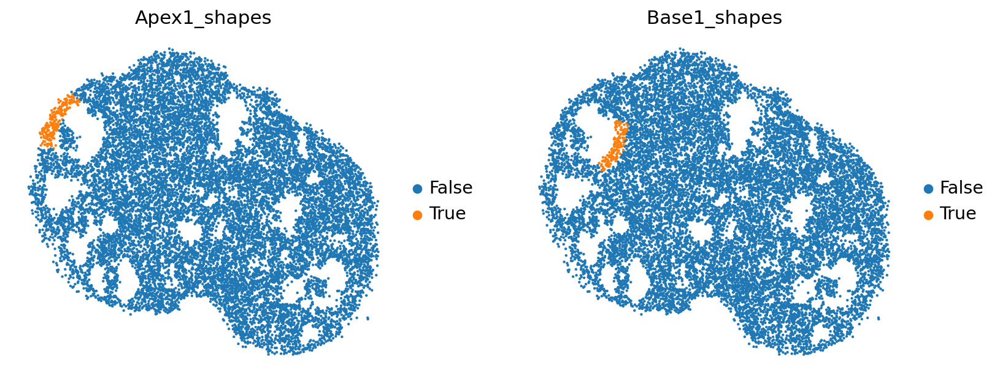

In [55]:
sc.settings.set_figure_params(dpi=80, facecolor='white', frameon=False, figsize=(5, 5))
sc.pl.spatial(adata, color = ["Apex1_shapes", "Base1_shapes"], spot_size=30, ncols=4, wspace=0.2)

In [67]:
adata.obs["napari"] = ["Apex_1" if adata.obs.loc[x,"Apex1_shapes"] else "Base_1" if adata.obs.loc[x,"Base1_shapes"]
 else "Apex_2" if adata.obs.loc[x,"Apex2_shapes"]
 else "Base_2" if adata.obs.loc[x,"Base2_shapes"]
 else "Apex_3" if adata.obs.loc[x,"Apex3_shapes"]
 else "Base_3" if adata.obs.loc[x,"Base3_shapes"]
 else "Apex_4" if adata.obs.loc[x,"Apex4_shapes"]
 else "Base_4" if adata.obs.loc[x,"Base4_shapes"]
 else "Apex_5" if adata.obs.loc[x,"Apex5_shapes"]
 else "Base_5" if adata.obs.loc[x,"Base5_shapes"]
 else pd.NA for x in adata.obs_names]

In [72]:
adata.obs["ROI"] = [pd.NA if pd.isna(x) else x.split("_")[0] for x in adata.obs["napari"]]
adata.obs["follicle#"] = [pd.NA if pd.isna(x) else x.split("_")[1] for x in adata.obs["napari"]]

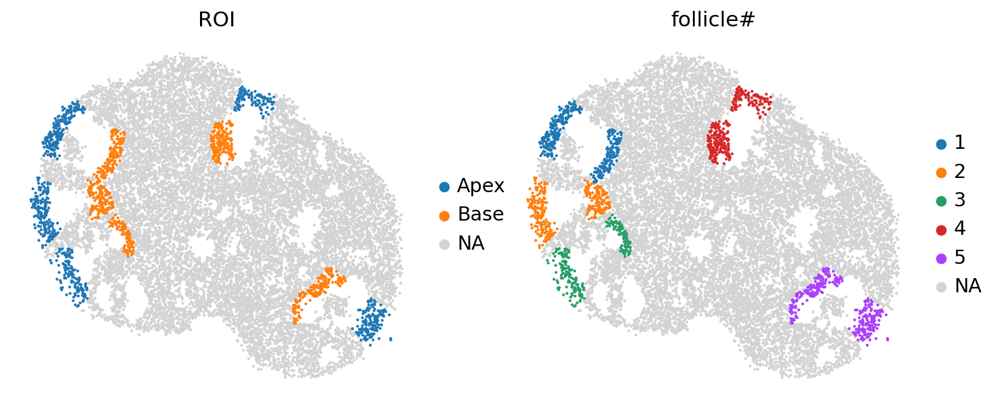

In [90]:
sc.pl.spatial(adata, color = ["ROI", "follicle#"], spot_size=30, ncols=4, wspace=0.1)

In [101]:
adata.obs["selection_celltype_pred_level1"] = [pd.NA if pd.isna(adata.obs.loc[x, "ROI"]) else adata.obs["Level1_max_pred_celltype"][x].split("Level1_")[1] for x in adata.obs_names]

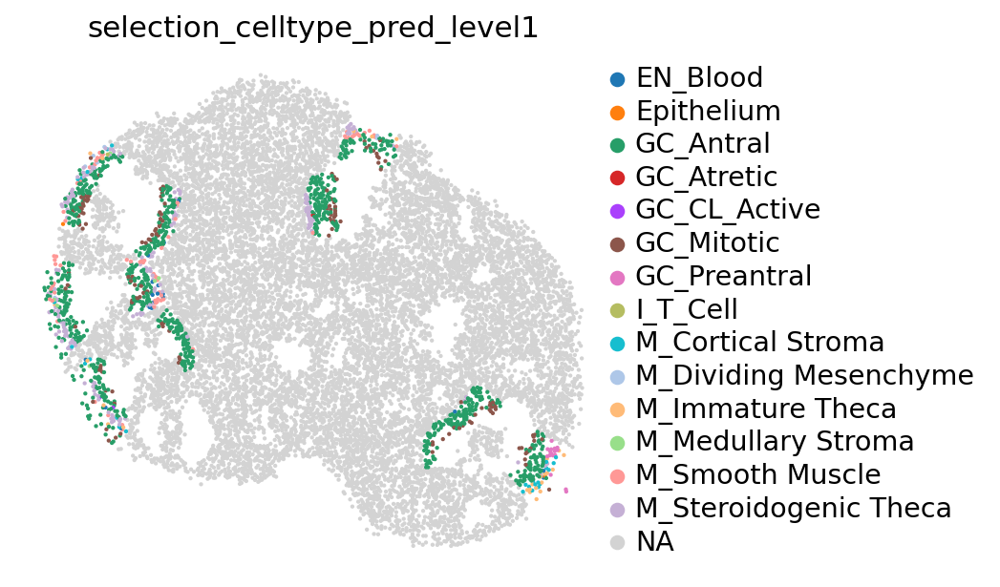

In [115]:
fig, ax = plt.subplots(figsize = (5.0, 5.0))
sc.pl.spatial(adata, color = ["selection_celltype_pred_level1"], spot_size=30, ncols=4, wspace=0.2, ax = ax, show=False)
plt.legend(ncol=1, loc = "right", frameon = False, labelspacing = 0.2, bbox_to_anchor = (1.65,0.5))
plt.show()

In [116]:
temp = adata[~adata.obs["ROI"].isin([pd.NA])]
temp

View of AnnData object with n_obs × n_vars = 1342 × 4717
    obs: 'barcode', 'x', 'y', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'leiden_1.0', 'leiden_1.2', 'leiden_1.5', 'spatial_neighbors_100_true', 'spatial_neighbors_100_false', 'Sample', 'Level1_total_abundance', 'Level1_EN_Blood', 'Level1_EN_Lymph', 'Level1_Epithelium', 'Level1_GC_Antral', 'Level1_GC_Atretic', 'Level1_GC_CL_Active', 'Level1_GC_CL_Lytic', 'Level1_GC_Estrous', 'Level1_GC_Mitotic', 'Level1_GC_Mural', 'Level1_GC_Preantral', 'Level1_I_B_Cell', 'Level1_I_Dendritic_Cell', 'Level1_I_Granulocyte', 'Level1_I_Macrophage', 'Level1_I_T_Cell', 'Level1_M_Cortical Stroma', 'Level1_M_Dividing Mesenchyme', 'Level1_M_Immature Theca', 'Level1_M_Medullary Stroma', 'Level1_M_Pericyte', 'Level1_M_Smooth Muscle', 'Level1_M_Steroidogenic Theca', 'Level1_Oocyte', 'Level1_max_pred', 'Level1_max_pred_celltype', 'Level0_total_abundance', 'Level0_Endothelium', 'Level0_Epithelium', 'Level0_Granulosa', 

In [118]:
sc.tl.rank_genes_groups(adata=temp, groupby="ROI", method="wilcoxon", key_added="rank_genes_df_ROI")

In [120]:
result = temp.uns['rank_genes_df_ROI']
groups = result['names'].dtype.names
celltype_markers = pd.DataFrame(
    {group + '_' + key[:-1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges','pvals']}).head(50)
celltype_markers

,Apex_name,Apex_logfoldchange,Apex_pval,Base_name,Base_logfoldchange,Base_pval
0,Col1a2,1.425988,3.299158e-07,Inhba,0.892295,1.640293e-21
1,Sparc,0.816361,3.013107e-06,Fst,1.071975,3.750011e-18
2,Rps12,0.234367,3.406886e-05,Foxo1,1.003113,2.113667e-13
3,Igfbp7,0.868553,4.491485e-05,Serpine2,0.645882,4.670681e-13
4,Rps8,0.192960,9.620094e-05,Calr,0.995280,6.850047e-13
5,Rps20,0.158920,1.010747e-04,Gja1,0.643694,5.234855e-12
6,Rps27a,0.249236,1.834129e-04,Inha,0.474064,6.053160e-11
7,Rps23,0.191707,7.409184e-04,Inhbb,0.647908,3.258860e-10
8,Rpl32,0.192400,7.445309e-04,Nap1l5,0.702441,3.437988e-10
9,Rpl23,0.179223,1.060258e-03,Hspa5,0.628971,4.272944e-10


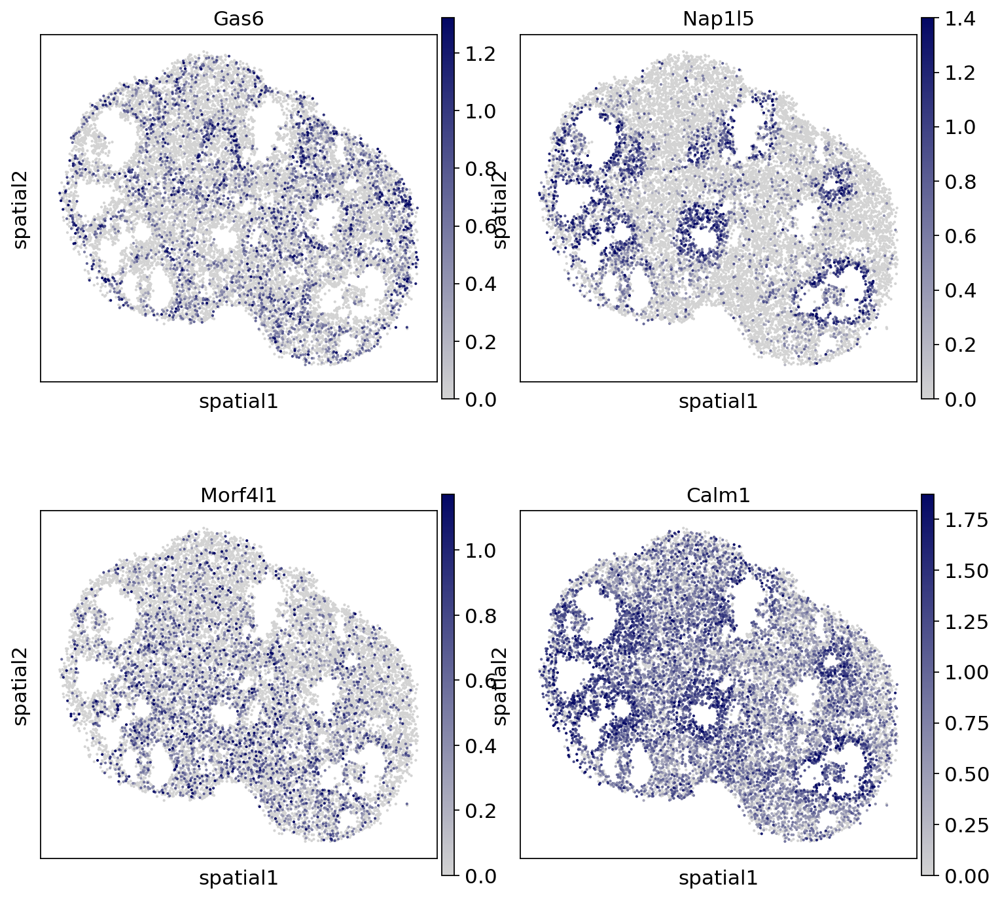

In [159]:
sc.pl.spatial(adata, color = ["Gas6", "Nap1l5", "Morf4l1", "Calm1"], cmap=sns.blend_palette(["lightgray", sns.xkcd_rgb["darkblue"]], as_cmap=True), spot_size=30, ncols=2, wspace=0.1, vmin=0, vmax='p99.2')

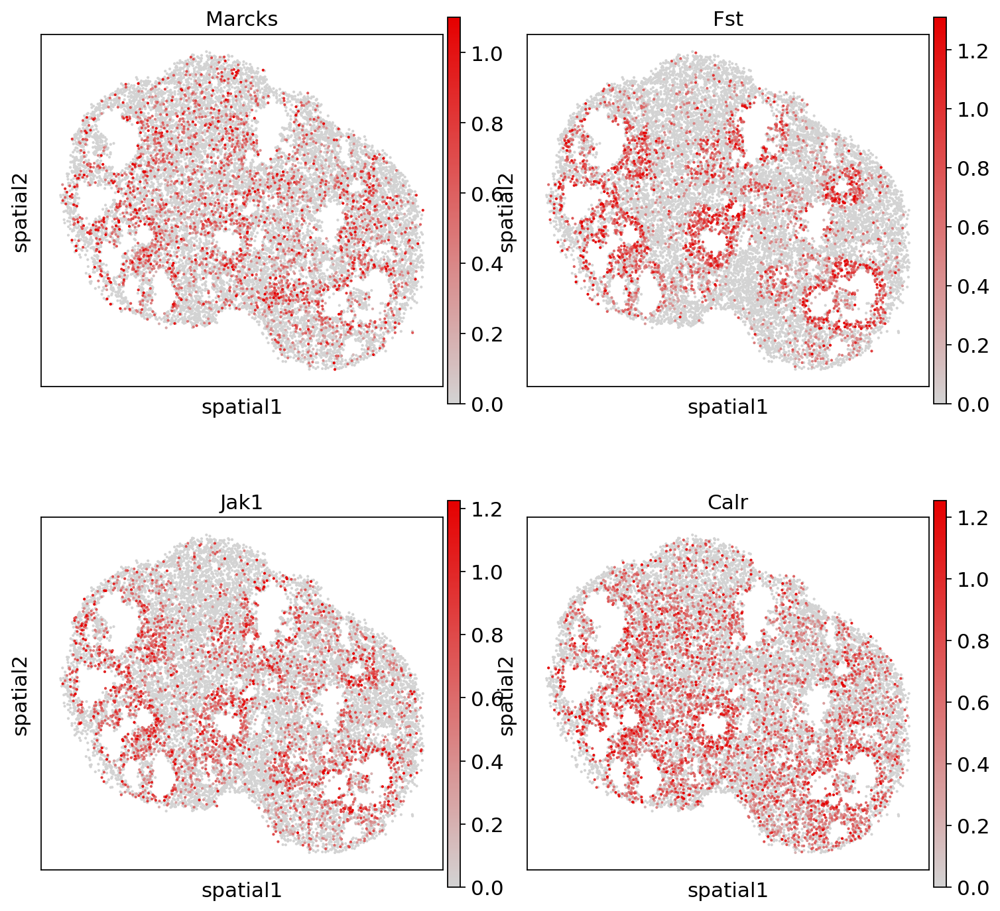

In [162]:
sc.pl.spatial(adata, color = ["Marcks", "Fst", "Jak1", "Calr"], cmap=sns.blend_palette(["lightgray", sns.xkcd_rgb["red"]], as_cmap=True), spot_size=30, ncols=2, wspace=0.1, vmin=0, vmax='p99.2')

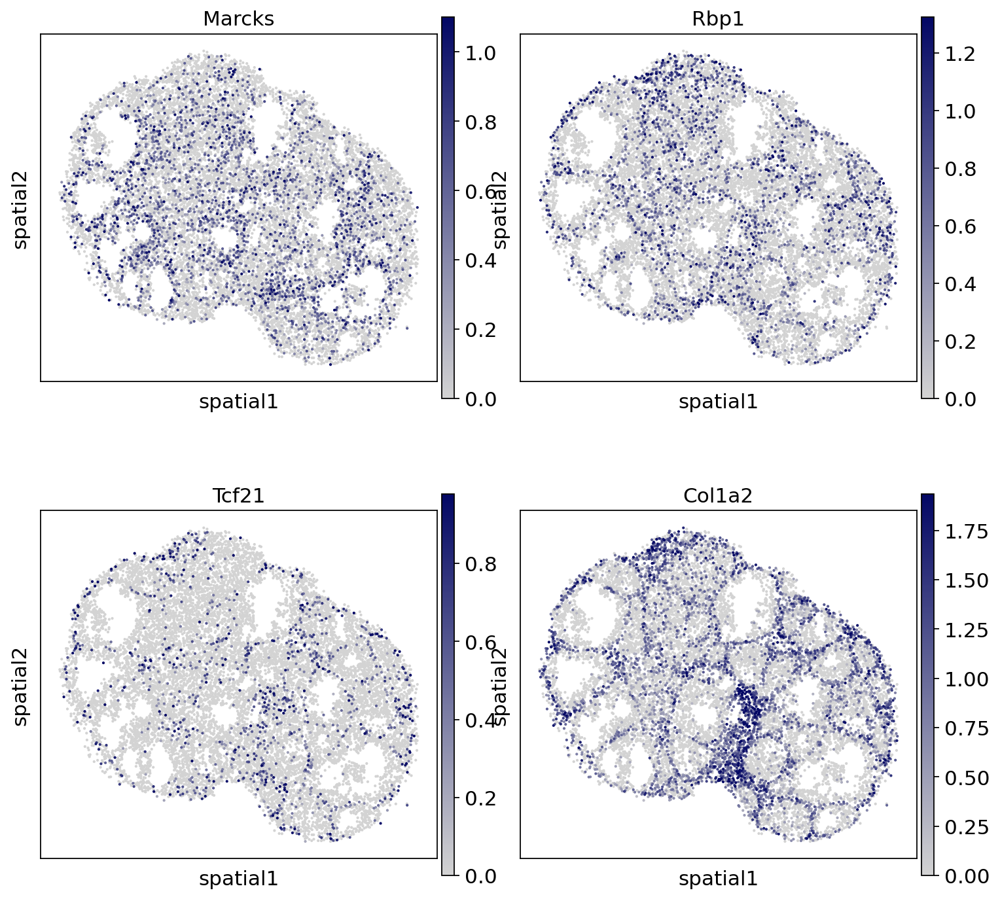

In [160]:
# cmap=sns.blend_palette(["lightgray", sns.xkcd_rgb["blood"]], as_cmap=True)
sc.pl.spatial(adata, color = ["Rarres2", "Rbp1", "Tcf21", "Col1a2"], cmap=sns.blend_palette(["lightgray", sns.xkcd_rgb["darkblue"]], as_cmap=True), spot_size=30, ncols=2, wspace=0.1, vmin=0, vmax='p99.2')

In [6]:
adata.obs["Selection"] = adata.obs["Level1_max_pred_celltype"]
adata.obs["Selection"][~adata.obs["Level1_max_pred_celltype_group"].isin(["GC"])] = pd.NA

KeyError: 'Level1_max_pred_celltype_group'

In [ ]:
sc.settings.set_figure_params(dpi=200, dpi_save= 300, fontsize=10, facecolor='white', frameon=False, figsize=(2.0, 2.0), vector_friendly = False, transparent=True, format="pdf")
grouping_var = "Selection"
fig, axs = plt.subplots(2,4, figsize = (16,8))
for i, sample in enumerate(samples_dict.keys()):
    subset = adata[adata.obs["Sample"] == sample]
#     subset.obs[grouping_var] = subset.obs[grouping_var].cat.set_categories(adata_ovary_combined.obs[grouping_var].cat.categories)
#     print(subset.obs[grouping_var].cat.categories)
    if i == 1:
        sc.pl.spatial(subset, color = [grouping_var], wspace= 0.5, spot_size = 30, frameon=False, title=sample, show=False, ax=axs[int(i/4), int(i%4)])
        handles, labels = axs[int(i/4), int(i%4)].get_legend_handles_labels()
        axs[int(i/4), int(i%4)].get_legend().remove()
    else: 
        sc.pl.spatial(subset, color = [grouping_var], wspace= 0.5, spot_size = 30, frameon=False, title=sample, show=False, legend_loc="none", ax=axs[int(i/4), int(i%4)])  
fig.legend(handles, labels, loc='right', bbox_to_anchor = (1.1,0.5))
plt.subplots_adjust(wspace=0, hspace=0)